In [1]:
## Notebook env: farnaz_spatial (farnaz_spatial kernel)
## this notebook quantifies and compares the frequency of each cell type across different regions and temperatures

In [1]:
import sys
import scanpy as sc
import anndata
import pandas as pd
import numpy as np
import os
import seaborn as sns

In [2]:
## load in the data

results_folder = '/home/ssobti/projects/farnaz_spatial/output_data/monkey/cell2location/multi_ref_annot'

# create paths and names to results folders for reference regression and cell2location models
ref_run_name = f'{results_folder}/reference_signatures'
run_name = f'{results_folder}/cell2location_map/N2_alpha200'

adata_file = f"{run_name}/sp.h5ad"
adata_vis = sc.read_h5ad(adata_file)

In [3]:
adata_vis.obs

,in_tissue,array_row,array_col,sample,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_50_genes,pct_counts_in_top_100_genes,pct_counts_in_top_200_genes,pct_counts_in_top_500_genes,mt_frac,_indices,_scvi_batch,_scvi_labels
spot_id,,,,,,,,,,,,,,,,
1149G_A1_096_AACACTTGGCAAGGAA-1,1,47,71,1149G_A1_096,24,3.218876,42.0,3.761200,100.000000,100.000000,100.000000,100.000000,0.0,0,0,0
1149G_A1_096_AACAGGATTCATAGTT-1,1,49,43,1149G_A1_096,29,3.401197,32.0,3.496508,100.000000,100.000000,100.000000,100.000000,0.0,1,0,0
1149G_A1_096_AACAGGTTATTGCACC-1,1,28,86,1149G_A1_096,293,5.683580,411.0,6.021023,33.333333,53.041363,77.372263,100.000000,0.0,2,0,0
1149G_A1_096_AACAGGTTCACCGAAG-1,1,51,41,1149G_A1_096,16,2.833213,20.0,3.044523,100.000000,100.000000,100.000000,100.000000,0.0,3,0,0
1149G_A1_096_AACATACTCATATGCG-1,1,50,6,1149G_A1_096,78,4.369448,96.0,4.574711,70.833333,100.000000,100.000000,100.000000,0.0,4,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1080B_D1_327_TGTTCTGCTCTGTCGT-1,1,39,39,1080B_D1_327,120,4.795791,132.0,4.890349,46.969697,84.848485,100.000000,100.000000,0.0,12377,3,0
1080B_D1_327_TGTTGCGTCCAAGATT-1,1,51,65,1080B_D1_327,675,6.516193,855.0,6.752270,21.520468,32.748538,44.444444,79.532164,0.0,12378,3,0
1080B_D1_327_TGTTGGAACCTTCCGC-1,1,35,35,1080B_D1_327,180,5.198497,203.0,5.318120,35.960591,60.591133,100.000000,100.000000,0.0,12379,3,0


In [4]:
adata_vis.obsm['q05_cell_abundance_w_sf']

,q05cell_abundance_w_sf_Adipocyte_progenitors,q05cell_abundance_w_sf_Adipocytes,q05cell_abundance_w_sf_B_cells,q05cell_abundance_w_sf_Brown_adipocytes,q05cell_abundance_w_sf_Endothelial_cells,q05cell_abundance_w_sf_Eosinophils,q05cell_abundance_w_sf_Epithelial_cells,q05cell_abundance_w_sf_Lymphatic_endothelial_cells,q05cell_abundance_w_sf_Macrophages,q05cell_abundance_w_sf_Mast_cells,q05cell_abundance_w_sf_Mesothelium,q05cell_abundance_w_sf_NK_cells,q05cell_abundance_w_sf_Neutrophils,q05cell_abundance_w_sf_Pericytes,q05cell_abundance_w_sf_Schwan_cells,q05cell_abundance_w_sf_Skeletal_muscle,q05cell_abundance_w_sf_T_cells,q05cell_abundance_w_sf_Tregs,q05cell_abundance_w_sf_Vascular_smooth_muscle,q05cell_abundance_w_sf_white adipocytes
spot_id,,,,,,,,,,,,,,,,,,,,
1149G_A1_096_AACACTTGGCAAGGAA-1,0.007844,0.010719,0.004108,0.010228,0.006179,0.003497,0.010419,0.006255,0.004987,0.004397,0.008767,0.003058,0.008496,0.006548,0.004820,0.006591,0.005071,0.005692,0.007294,0.012479
1149G_A1_096_AACAGGATTCATAGTT-1,0.007165,0.010402,0.003574,0.010789,0.006428,0.003280,0.011504,0.006789,0.005219,0.003991,0.007401,0.003444,0.007685,0.004826,0.004432,0.006568,0.003714,0.004921,0.006043,0.014035
1149G_A1_096_AACAGGTTATTGCACC-1,0.017109,0.045044,0.021510,0.020175,0.029022,0.012642,0.071468,0.044552,0.021888,0.009552,0.021853,0.011576,0.048411,0.211948,0.102668,0.019710,0.016003,0.010480,0.175353,0.073156
1149G_A1_096_AACAGGTTCACCGAAG-1,0.007962,0.010064,0.003871,0.010348,0.005705,0.003917,0.009990,0.006551,0.005460,0.005390,0.006937,0.003163,0.006549,0.004303,0.004953,0.006811,0.003609,0.004334,0.005889,0.013468
1149G_A1_096_AACATACTCATATGCG-1,0.009670,0.013783,0.004863,0.015471,0.006972,0.006198,0.017739,0.007106,0.006213,0.003527,0.016547,0.004972,0.009238,0.005347,0.006456,0.015466,0.005923,0.005074,0.027112,0.018411
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1080B_D1_327_TGTTCTGCTCTGTCGT-1,0.011718,0.007284,0.002291,0.008235,0.004485,0.003887,0.007327,0.004963,0.004225,0.003331,0.007351,0.003343,0.069349,0.003850,0.004652,0.004918,0.003163,0.004179,0.004306,0.009355
1080B_D1_327_TGTTGCGTCCAAGATT-1,0.017298,0.023825,0.009032,0.133569,0.037589,0.004694,0.021597,0.007365,0.006941,0.006497,0.007043,0.012494,0.044536,0.005566,0.043691,0.025192,0.008230,0.004744,0.026212,0.025659
1080B_D1_327_TGTTGGAACCTTCCGC-1,0.014098,0.008230,0.006999,0.008429,0.006094,0.003426,0.007240,0.007476,0.007436,0.003301,0.008293,0.003468,0.008002,0.008567,0.009193,0.006471,0.006980,0.005522,0.005703,0.009601


In [5]:
### comparing cell type frequencies across slides using celltype thresholds
## for each cell type in a given slide, find the mean of the 95% quantile of spots in each slide, and set the threshold to be 50% of that mean
## count percent of cells that are above the threshold in each slide and compare across slides

In [6]:
deconvoluted_data = adata_vis.obsm['q05_cell_abundance_w_sf']
maxes = deconvoluted_data.quantile(0.99, axis = 0)
deconvoluted_data['sample'] = adata_vis.obs['sample']


normalized_deconvoluted_dict = {}
deconvoluted_counts = {}
deconvoluted_proportions = {}

for slide in deconvoluted_data['sample'].unique():
    normalized_deconvoluted_dict[slide] = deconvoluted_data.loc[deconvoluted_data['sample'] == slide, :].drop(columns = ['sample'])
    normalized_deconvoluted_dict[slide] = normalized_deconvoluted_dict[slide]/maxes ## normalized_deconvoluted_dict[slide].quantile(0.95) ## could divide by maxes2 instead
    deconvoluted_counts[slide] = normalized_deconvoluted_dict[slide] > 0.75
    deconvoluted_counts[slide] = deconvoluted_counts[slide].astype(int)
    deconvoluted_proportions[slide] = deconvoluted_counts[slide].sum(axis = 0)/deconvoluted_counts[slide].count(axis = 0)

combined_deconvoluted_counts = pd.concat(deconvoluted_counts.values(), axis = 0)
combined_deconvoluted_counts.reindex(adata_vis.obs.index)

,q05cell_abundance_w_sf_Adipocyte_progenitors,q05cell_abundance_w_sf_Adipocytes,q05cell_abundance_w_sf_B_cells,q05cell_abundance_w_sf_Brown_adipocytes,q05cell_abundance_w_sf_Endothelial_cells,q05cell_abundance_w_sf_Eosinophils,q05cell_abundance_w_sf_Epithelial_cells,q05cell_abundance_w_sf_Lymphatic_endothelial_cells,q05cell_abundance_w_sf_Macrophages,q05cell_abundance_w_sf_Mast_cells,q05cell_abundance_w_sf_Mesothelium,q05cell_abundance_w_sf_NK_cells,q05cell_abundance_w_sf_Neutrophils,q05cell_abundance_w_sf_Pericytes,q05cell_abundance_w_sf_Schwan_cells,q05cell_abundance_w_sf_Skeletal_muscle,q05cell_abundance_w_sf_T_cells,q05cell_abundance_w_sf_Tregs,q05cell_abundance_w_sf_Vascular_smooth_muscle,q05cell_abundance_w_sf_white adipocytes
spot_id,,,,,,,,,,,,,,,,,,,,
1149G_A1_096_AACACTTGGCAAGGAA-1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1149G_A1_096_AACAGGATTCATAGTT-1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1149G_A1_096_AACAGGTTATTGCACC-1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1149G_A1_096_AACAGGTTCACCGAAG-1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1149G_A1_096_AACATACTCATATGCG-1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1080B_D1_327_TGTTCTGCTCTGTCGT-1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1080B_D1_327_TGTTGCGTCCAAGATT-1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1080B_D1_327_TGTTGGAACCTTCCGC-1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [6]:
deconvoluted_data = adata_vis.obsm['q05_cell_abundance_w_sf']
maxes = deconvoluted_data.quantile(0.99, axis = 0)
maxes3 = deconvoluted_data.quantile(0.95, axis = 0)
upper_cut_cell_types = ['Brown_adipocytes', 'white adipocytes', 'Neutrophils', 'Pericytes', 'Skeletal_muscle', 'T_cells', 'Tregs', 'Vascular_smooth_muscle', 'NK_cells', 'Mast_cells', 'Mesothelium', 'Macrophages', 'B_cells']
final_maxes = [maxes[index] if name in upper_cut_cell_types else maxes3[index] for index, name in enumerate(deconvoluted_data.columns.str.replace('q05cell_abundance_w_sf_', ''))]
deconvoluted_data['sample'] = adata_vis.obs['sample']

normalized_deconvoluted_dict = {}
deconvoluted_counts = {}
deconvoluted_proportions = {}

maxes2 = [1, 0.145, 0.35, 0.45,
         0.4, 0.11, 0.0675, 0.1475,
          0.46, 0.04, 0.0725, 0.215,
          0.235, 0.49, 0.66, 0.325,
          0.31, 0.275, 0.225, 0.095]

for slide in deconvoluted_data['sample'].unique():
    normalized_deconvoluted_dict[slide] = deconvoluted_data.loc[deconvoluted_data['sample'] == slide, :].drop(columns = ['sample'])
    normalized_deconvoluted_dict[slide] = normalized_deconvoluted_dict[slide]/final_maxes ## normalized_deconvoluted_dict[slide].quantile(0.95) ## could divide by maxes2 instead
    deconvoluted_counts[slide] = normalized_deconvoluted_dict[slide] > 0.75
    deconvoluted_counts[slide] = deconvoluted_counts[slide].astype(int)
    deconvoluted_proportions[slide] = deconvoluted_counts[slide].sum(axis = 0)/deconvoluted_counts[slide].count(axis = 0)

combined_deconvoluted_counts = pd.concat(deconvoluted_counts.values(), axis = 0)
combined_deconvoluted_counts.reindex(adata_vis.obs.index)


,q05cell_abundance_w_sf_Adipocyte_progenitors,q05cell_abundance_w_sf_Adipocytes,q05cell_abundance_w_sf_B_cells,q05cell_abundance_w_sf_Brown_adipocytes,q05cell_abundance_w_sf_Endothelial_cells,q05cell_abundance_w_sf_Eosinophils,q05cell_abundance_w_sf_Epithelial_cells,q05cell_abundance_w_sf_Lymphatic_endothelial_cells,q05cell_abundance_w_sf_Macrophages,q05cell_abundance_w_sf_Mast_cells,q05cell_abundance_w_sf_Mesothelium,q05cell_abundance_w_sf_NK_cells,q05cell_abundance_w_sf_Neutrophils,q05cell_abundance_w_sf_Pericytes,q05cell_abundance_w_sf_Schwan_cells,q05cell_abundance_w_sf_Skeletal_muscle,q05cell_abundance_w_sf_T_cells,q05cell_abundance_w_sf_Tregs,q05cell_abundance_w_sf_Vascular_smooth_muscle,q05cell_abundance_w_sf_white adipocytes
spot_id,,,,,,,,,,,,,,,,,,,,
count-A1_AAACAAGTATCTCCCA-1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
count-A1_AAACACCAATAACTGC-1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
count-A1_AAACAGCTTTCAGAAG-1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
count-A1_AAACAGGGTCTATATT-1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
count-A1_AAACAGTGTTCCTGGG-1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
count-D1_TTGTTAGCAAATTCGA-1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0
count-D1_TTGTTCAGTGTGCTAC-1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
count-D1_TTGTTTCACATCCAGG-1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [7]:
[name for index, name in enumerate(deconvoluted_data.columns.str.replace('q05cell_abundance_w_sf_', '')) if name not in ['Brown_adipocytes', 'white adipocytes', 'Neutrophils', 'Pericytes', 'Skeletal_muscle', 'T_cells', 'Tregs', 'Vascular_smooth_muscle', 'NK_cells', 'Mast_cells', 'Mesothelium', 'Macrophages', 'B_cells']]

['Adipocyte_progenitors',
 'Adipocytes',
 'Endothelial_cells',
 'Eosinophils',
 'Epithelial_cells',
 'Lymphatic_endothelial_cells',
 'Schwan_cells',
 'sample']

In [7]:
thresholds_df = pd.DataFrame(zip(deconvoluted_data.columns.str.replace('q05cell_abundance_w_sf_', ''), 
                                   np.array(maxes) * 0.75), index = None, columns = ['cell_type', 'threshold'])

#thresholds_df.to_csv('~/projects/farnaz_spatial/notebooks/post_cell2loc_analysis/thresholds.csv')
thresholds_df

,cell_type,threshold
0,Adipocyte_progenitors,0.319332
1,Adipocytes,0.170600
2,B_cells,1.244008
3,Brown_adipocytes,0.736605
4,Endothelial_cells,0.403887
5,Eosinophils,0.316136
6,Epithelial_cells,0.299538
7,Lymphatic_endothelial_cells,0.522724
8,Macrophages,0.587282
9,Mast_cells,0.452109


In [7]:
thresholds_df = pd.DataFrame(zip(deconvoluted_data.columns.str.replace('q05cell_abundance_w_sf_', ''), 
                                   np.array(final_maxes) * 0.75), index = None, columns = ['cell_type', 'threshold'])

#thresholds_df.to_csv('~/projects/farnaz_spatial/notebooks/post_cell2loc_analysis/thresholds.csv')
thresholds_df

,cell_type,threshold
0,Adipocyte_progenitors,0.307305
1,Adipocytes,0.103200
2,B_cells,0.268408
3,Brown_adipocytes,0.381211
4,Endothelial_cells,0.210508
5,Eosinophils,0.038736
6,Epithelial_cells,0.028756
7,Lymphatic_endothelial_cells,0.063130
8,Macrophages,0.312653
9,Mast_cells,0.019689


In [9]:
slide = '1149G_A1_096'
deconvoluted_data.loc[deconvoluted_data['sample'] == slide, :].drop(columns = ['sample'])

,q05cell_abundance_w_sf_Adipocyte_progenitors,q05cell_abundance_w_sf_Adipocytes,q05cell_abundance_w_sf_B_cells,q05cell_abundance_w_sf_Brown_adipocytes,q05cell_abundance_w_sf_Endothelial_cells,q05cell_abundance_w_sf_Eosinophils,q05cell_abundance_w_sf_Epithelial_cells,q05cell_abundance_w_sf_Lymphatic_endothelial_cells,q05cell_abundance_w_sf_Macrophages,q05cell_abundance_w_sf_Mast_cells,q05cell_abundance_w_sf_Mesothelium,q05cell_abundance_w_sf_NK_cells,q05cell_abundance_w_sf_Neutrophils,q05cell_abundance_w_sf_Pericytes,q05cell_abundance_w_sf_Schwan_cells,q05cell_abundance_w_sf_Skeletal_muscle,q05cell_abundance_w_sf_T_cells,q05cell_abundance_w_sf_Tregs,q05cell_abundance_w_sf_Vascular_smooth_muscle,q05cell_abundance_w_sf_white adipocytes
spot_id,,,,,,,,,,,,,,,,,,,,
1149G_A1_096_AACACTTGGCAAGGAA-1,0.007844,0.010719,0.004108,0.010228,0.006179,0.003497,0.010419,0.006255,0.004987,0.004397,0.008767,0.003058,0.008496,0.006548,0.004820,0.006591,0.005071,0.005692,0.007294,0.012479
1149G_A1_096_AACAGGATTCATAGTT-1,0.007165,0.010402,0.003574,0.010789,0.006428,0.003280,0.011504,0.006789,0.005219,0.003991,0.007401,0.003444,0.007685,0.004826,0.004432,0.006568,0.003714,0.004921,0.006043,0.014035
1149G_A1_096_AACAGGTTATTGCACC-1,0.017109,0.045044,0.021510,0.020175,0.029022,0.012642,0.071468,0.044552,0.021888,0.009552,0.021853,0.011576,0.048411,0.211948,0.102668,0.019710,0.016003,0.010480,0.175353,0.073156
1149G_A1_096_AACAGGTTCACCGAAG-1,0.007962,0.010064,0.003871,0.010348,0.005705,0.003917,0.009990,0.006551,0.005460,0.005390,0.006937,0.003163,0.006549,0.004303,0.004953,0.006811,0.003609,0.004334,0.005889,0.013468
1149G_A1_096_AACATACTCATATGCG-1,0.009670,0.013783,0.004863,0.015471,0.006972,0.006198,0.017739,0.007106,0.006213,0.003527,0.016547,0.004972,0.009238,0.005347,0.006456,0.015466,0.005923,0.005074,0.027112,0.018411
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1149G_A1_096_TGTTGCGTCCAAGATT-1,0.009916,0.012858,0.004713,0.012113,0.005617,0.004474,0.013826,0.011563,0.005462,0.004246,0.009605,0.004129,0.007112,0.005604,0.008983,0.007087,0.005190,0.004841,0.006848,0.016404
1149G_A1_096_TGTTGGAACCTTCCGC-1,0.009973,0.012292,0.004205,0.011475,0.009771,0.004055,0.012401,0.008953,0.008492,0.004766,0.012872,0.005896,0.009260,0.012955,0.007953,0.007889,0.007130,0.006197,0.007022,0.017021
1149G_A1_096_TGTTGGAACGAGGTCA-1,0.206343,0.025433,0.104853,0.012632,0.730156,0.021564,0.171559,0.146602,0.025786,0.035372,0.142813,0.041689,0.092795,0.130227,0.066761,0.019427,0.053309,0.063152,1.429140,0.048286


In [10]:
## make a heatmap of the proportions of each cell type in each slide
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

deconvoluted_proportions_df = pd.DataFrame.from_dict(deconvoluted_proportions)
deconvoluted_proportions_df.columns = ['1149G_A1_096', '1572G_D1_096', '1080T_A1_327', '1080B_D1_327']
deconvoluted_proportions_df.index = deconvoluted_proportions_df.index.str.replace('q05cell_abundance_w_sf_', '')

In [13]:
adata_vis.obs[adata_vis.uns['mod']['factor_names']] = adata_vis.obsm['q05_cell_abundance_w_sf'].drop(columns = ['sample'])
adata_vis.obs[adata_vis.uns['mod']['factor_names'] + '_binary'] = combined_deconvoluted_counts

In [14]:
def select_slide(adata, s, batch_key="sample"):
    r"""This function selects the data for one slide from the spatial anndata object.

    :param adata: Anndata object with multiple spatial experiments
    :param s: name of selected experiment
    :param batch_key: column in adata.obs listing experiment name for each location
    """

    slide = adata[adata.obs[batch_key].isin([s]), :].copy()
    s_keys = list(slide.uns["spatial"].keys())
    s_spatial = np.array(s_keys)[[s in k for k in s_keys]][0]

    slide.uns["spatial"] = {s_spatial: slide.uns["spatial"][s_spatial]}

    return slide


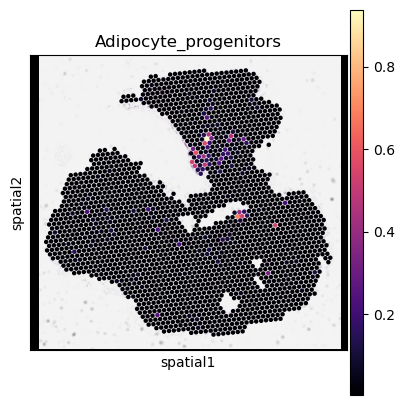

In [15]:
slide = select_slide(adata_vis, '1149G_A1_096')
with plt.rc_context({'axes.facecolor':  'black',
                     'figure.figsize': [4.5, 5]}):

    sc.pl.spatial(slide, cmap='magma',
                  # show first 8 cell types
                  color=list(slide.uns['mod']['factor_names'])[0], img_key='hires', size = 1.3)

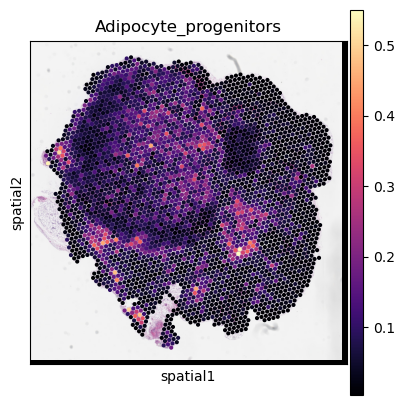

In [16]:
slide = select_slide(adata_vis, '1572G_D1_096')
with plt.rc_context({'axes.facecolor':  'black',
                     'figure.figsize': [4.5, 5]}):

    sc.pl.spatial(slide, cmap='magma',
                  # show first 8 cell types
                  color=list(slide.uns['mod']['factor_names'])[0], img_key='hires', size = 1.3)

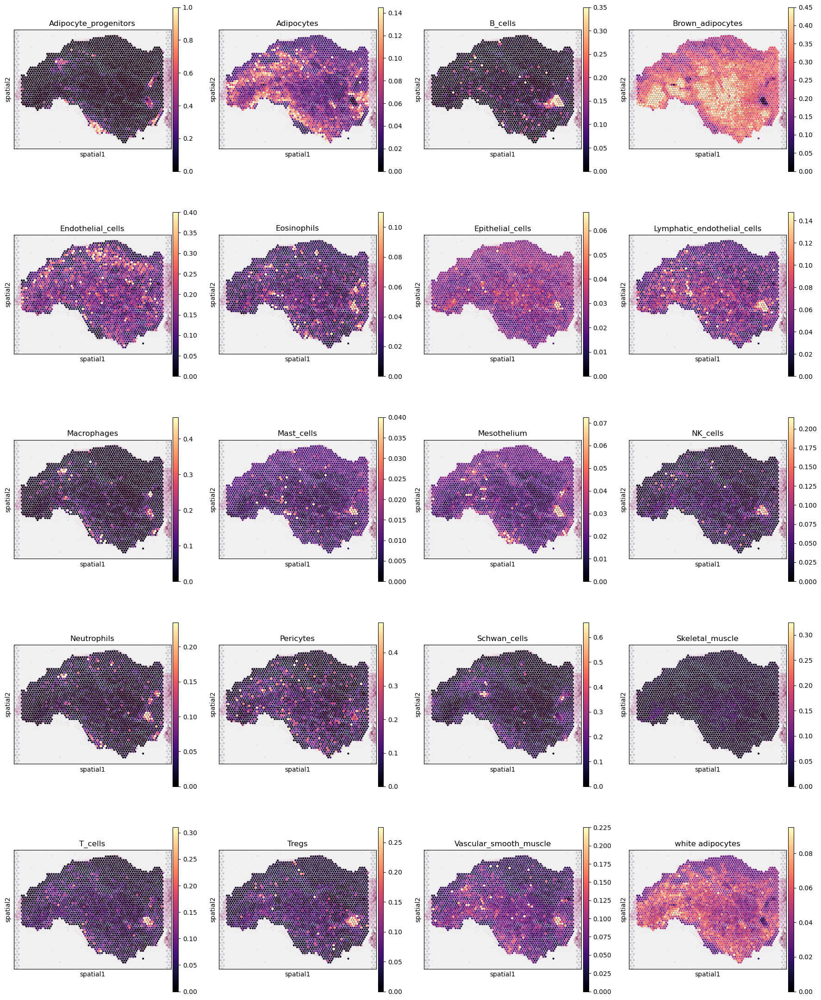

In [14]:
maxes2 = [1, 0.145, 0.35, 0.45,
         0.4, 0.11, 0.0675, 0.1475,
          0.46, 0.04, 0.0725, 0.215,
          0.235, 0.49, 0.66, 0.325,
          0.31, 0.275, 0.225, 0.095]

slide = select_slide(adata_vis, 'count-B1')
with plt.rc_context({'axes.facecolor':  'black',
                     'figure.figsize': [4.5, 5]}):

    sc.pl.spatial(slide, cmap='magma',
                  # show first 8 cell types
                  color=list(slide.uns['mod']['factor_names']),
                  ncols=4, size=1.3,
                  img_key='hires',
                  # limit color scale at 99.2% quantile of cell abundance
                  vmin=0, vmax=maxes2, library_id='count-B1', show = True
                 )

## why is library_id still needed after selecting the slide?

## Binary slides

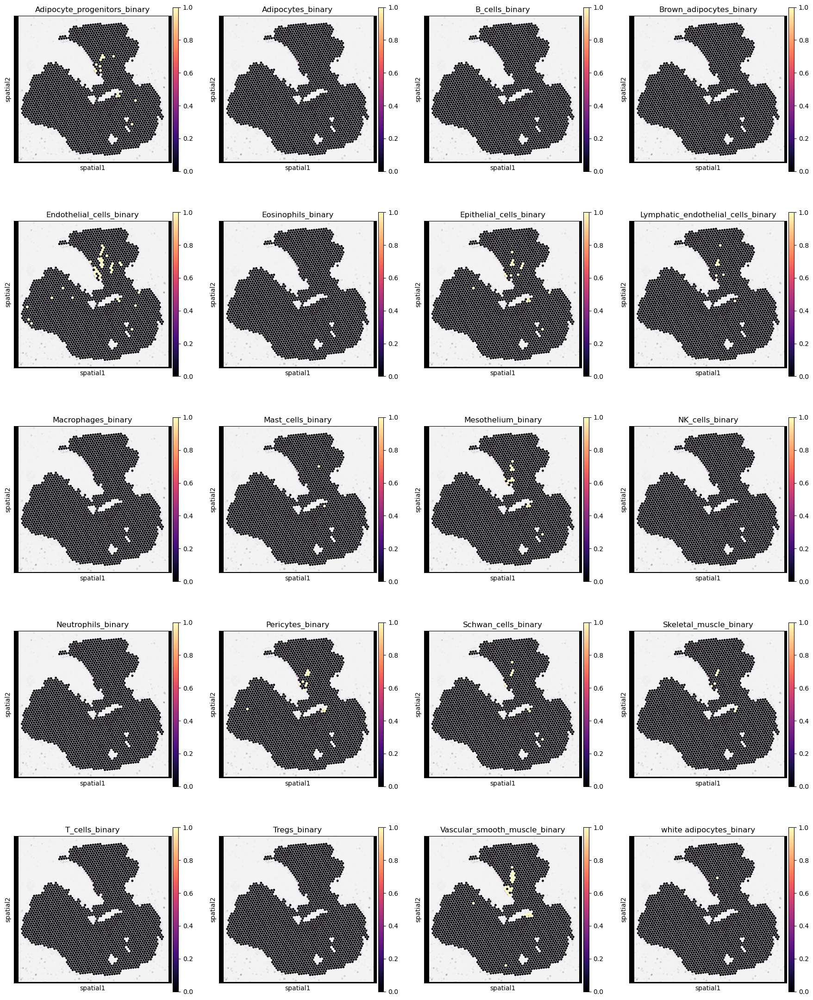

In [18]:
slide = select_slide(adata_vis, '1149G_A1_096')
with plt.rc_context({'axes.facecolor':  'black',
                     'figure.figsize': [4.5, 5]}):

    sc.pl.spatial(slide, cmap='magma',
                  # show first 8 cell types
                  color=list(slide.uns['mod']['factor_names'] + '_binary'),
                  ncols=4, size=1.3,
                  img_key='hires',
                  # limit color scale at 99.2% quantile of cell abundance
                  vmin=0, vmax=1, library_id='1149G_A1_096', show = True
                 )

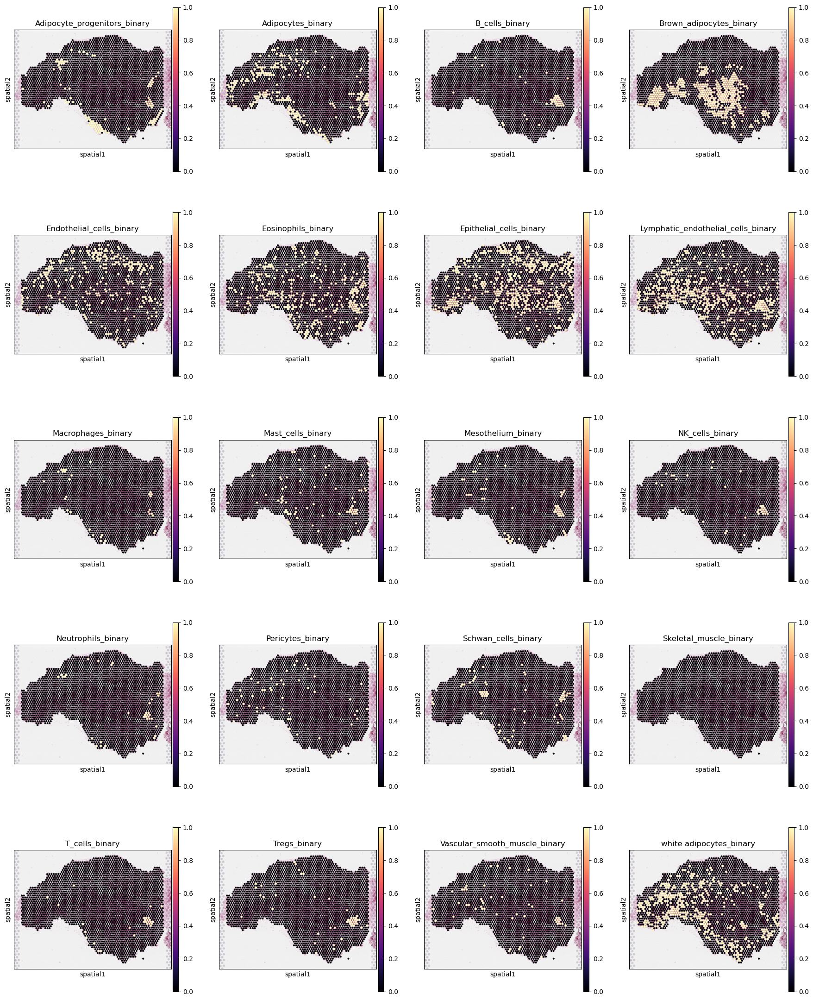

In [16]:
slide = select_slide(adata_vis, 'count-B1')
with plt.rc_context({'axes.facecolor':  'black',
                     'figure.figsize': [4.5, 5]}):

    sc.pl.spatial(slide, cmap='magma',
                  # show first 8 cell types
                  color=list(slide.uns['mod']['factor_names'] + '_binary'),
                  ncols=4, size=1.3,
                  img_key='hires',
                  # limit color scale at 99.2% quantile of cell abundance
                  vmin=0, vmax=1, library_id='count-B1', show = True
                 )

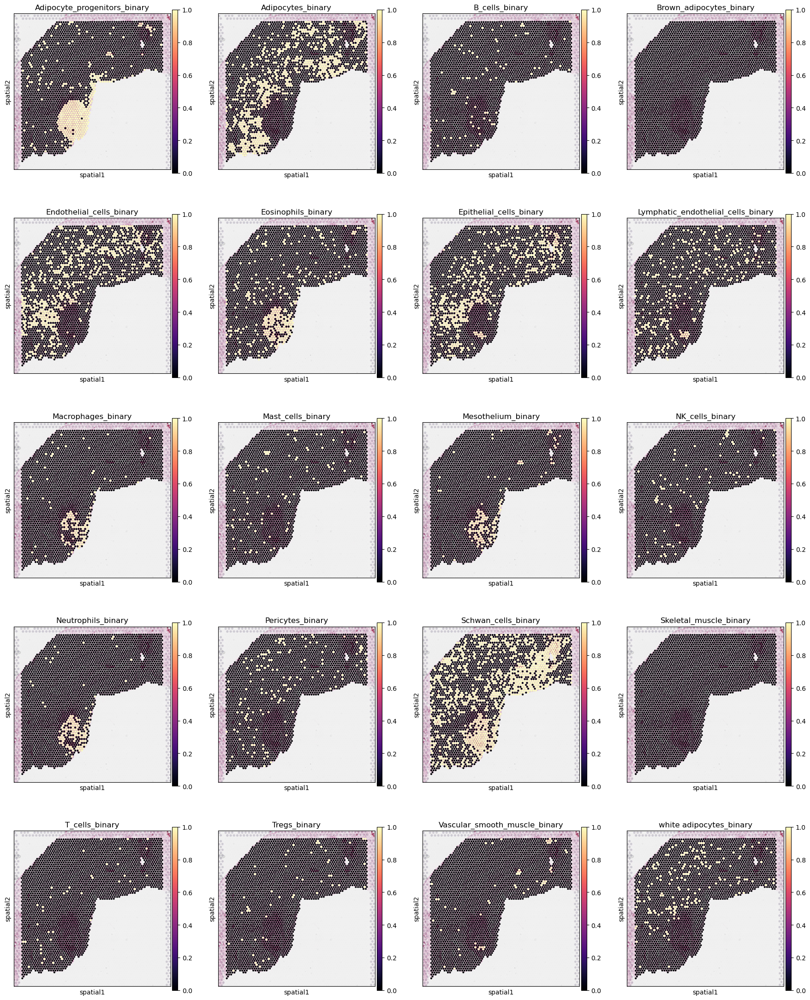

In [17]:
slide = select_slide(adata_vis, 'count-C1')
with plt.rc_context({'axes.facecolor':  'black',
                     'figure.figsize': [4.5, 5]}):

    sc.pl.spatial(slide, cmap='magma',
                  # show first 8 cell types
                  color=list(slide.uns['mod']['factor_names'] + '_binary'),
                  ncols=4, size=1.3,
                  img_key='hires',
                  # limit color scale at 99.2% quantile of cell abundance
                  vmin=0, vmax=1, library_id='count-C1', show = True
                 )

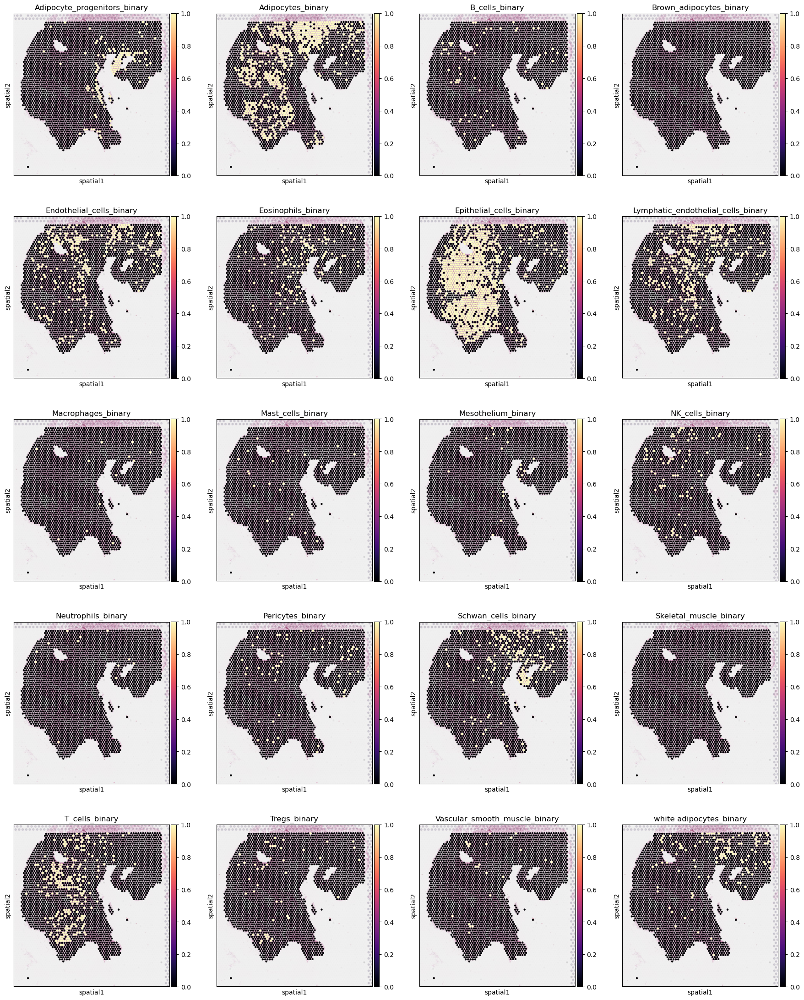

In [18]:
slide = select_slide(adata_vis, 'count-D1')
with plt.rc_context({'axes.facecolor':  'black',
                     'figure.figsize': [4.5, 5]}):

    sc.pl.spatial(slide, cmap='magma',
                  # show first 8 cell types
                  color=list(slide.uns['mod']['factor_names'] + '_binary'),
                  ncols=4, size=1.3,
                  img_key='hires',
                  # limit color scale at 99.2% quantile of cell abundance
                  vmin=0, vmax=1, library_id='count-D1', show = True
                 )

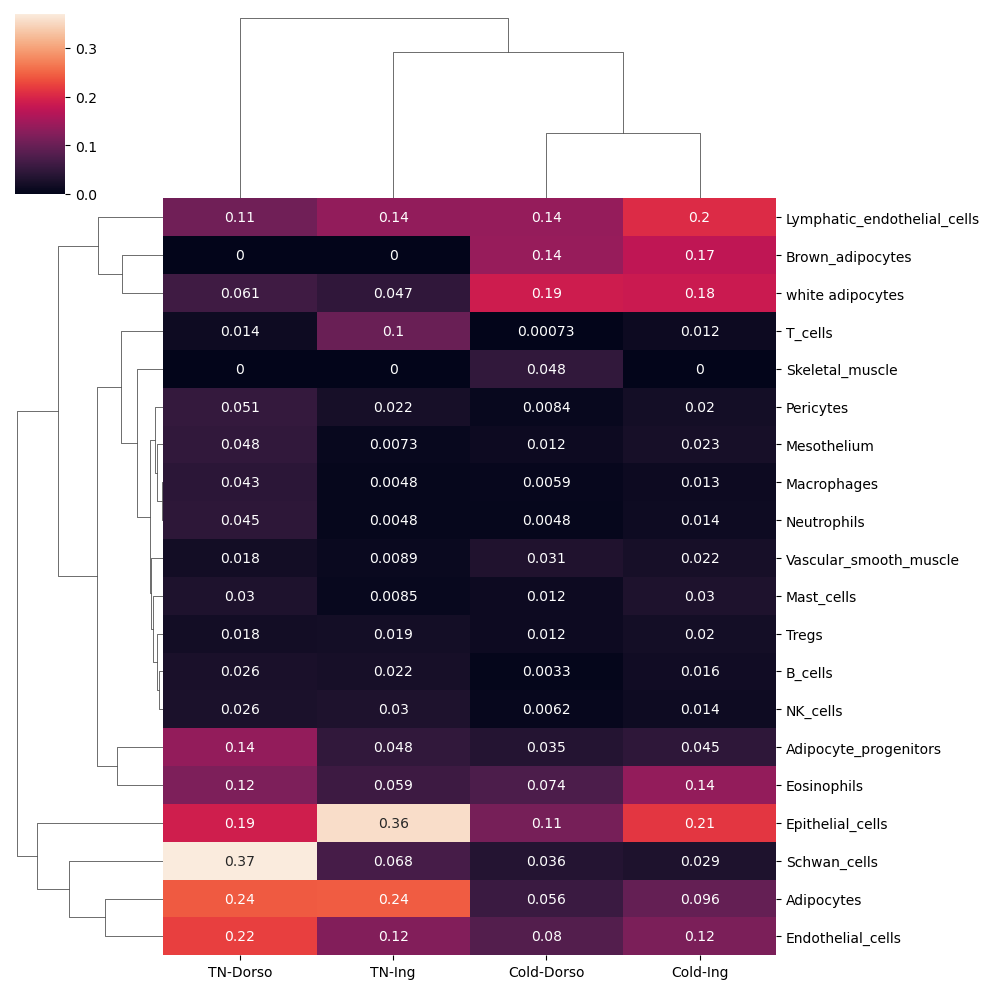

In [16]:
## make heatmap of deconvoluted_proportions_df
ax = sns.clustermap(deconvoluted_proportions_df, annot = True)

In [21]:
## cell type frequency across all slides
combined_counts = pd.concat(deconvoluted_counts.values())
combined_props = combined_counts.sum(axis = 0)/combined_counts.count(axis = 0)

In [38]:
df = pd.DataFrame(combined_props)
df.index = df.index.str.replace('q05cell_abundance_w_sf_','')

Text(0, 0.5, 'Proportion')

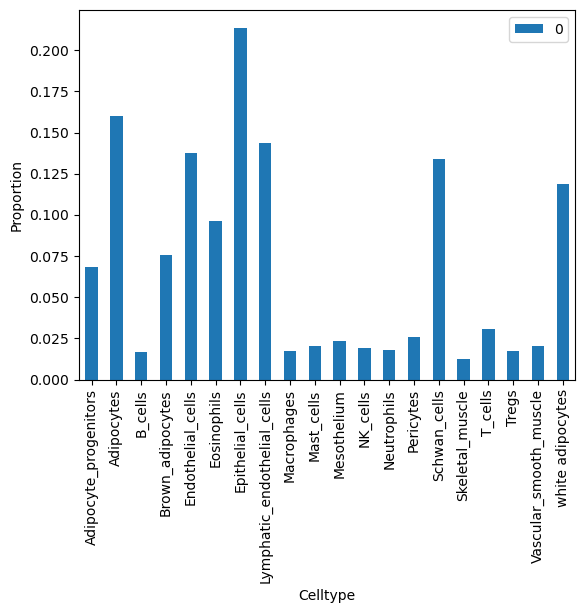

In [42]:
import matplotlib.pyplot as plt
 

# create stacked bar chart for monthly temperatures
df.plot(kind='bar', stacked=False)
 
# labels for x & y axis
plt.xlabel('Celltype')
plt.ylabel('Proportion')